In [1]:
using DriftDiffusionModels
using Plots

In [34]:
# create a DDM we will sample RT and choices from
B = 3
v = 0.23
α₀ = 0
σ = 1.0 # default value always

ddm = DriftDiffusionModel(B, v, α₀, σ)

# now we sample
data = simulateDDM(ddm, 10000, 1e-6)

10000-element Vector{DDMResult}:
 DDMResult(4.561755000283728, 1)
 DDMResult(13.108810996940882, 1)
 DDMResult(1.7345989999474851, 1)
 DDMResult(5.607775000429939, 1)
 DDMResult(11.20318999836705, 1)
 DDMResult(5.829785000460971, 1)
 DDMResult(7.252742000659869, 1)
 DDMResult(4.905462000331771, -1)
 DDMResult(6.555798000562452, 1)
 DDMResult(5.2631610003817695, 1)
 ⋮
 DDMResult(5.45139200040808, -1)
 DDMResult(1.1614779999946339, 1)
 DDMResult(8.52966100036792, 1)
 DDMResult(1.4008669999749401, 1)
 DDMResult(3.5688110001449367, 1)
 DDMResult(5.2955550003862975, 1)
 DDMResult(3.8439330001833927, 1)
 DDMResult(20.066963998957775, 1)
 DDMResult(9.762733999445087, 1)

In [35]:
data_1 = [x.rt for x in data if x.choice==1]
data_0 = [x.rt for x in data if x.choice==-1]

2011-element Vector{Float64}:
  4.905462000331771
  6.677570000579473
  3.8641340001862163
  1.4805709999683832
  1.6072269999579636
 10.932740998569454
 24.12629400313059
  1.5937939999590687
  3.3858470001193623
  3.4210020001242762
  ⋮
  5.333386000391585
  5.916724000473123
  1.5264759999646067
  2.5089789999967955
  4.557457000283128
  9.785663999427927
 28.285958007406542
  2.324618999971026
  5.45139200040808

In [103]:
ddm_times = [x for x in 0:0.0001:100]
ddm_probs_1 = [DriftDiffusionModels.wfpt(t, -v, 2*B, 1 - (α₀ + B)) for t in ddm_times]
ddm_probs_0 = [DriftDiffusionModels.wfpt(t, v, 2*B, (α₀ + B)) for t in ddm_times]

1000001-element Vector{Float64}:
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 0.0
 ⋮
 3.4619212731280844e-9
 3.461864661540543e-9
 3.461808050878745e-9
 3.461751441142681e-9
 3.4616948323323413e-9
 3.4616382244477013e-9
 3.461581617488758e-9
 3.4615250114554793e-9
 3.46146840634786e-9

In [106]:
area = 0.0
for i in 2:length(ddm_times)
    # calculate definite integral using the trapezoid rule
    area += (ddm_times[i] - ddm_times[i-1]) * ((ddm_probs_1[i] + ddm_probs_1[i-1]) / 2)
end
println("Area under the curve: ", area)

Area under the curve: -0.3578779814137506


In [112]:
1/-0.357

-2.801120448179272

In [ ]:
1/

In [121]:
# probability density function over the lower boundary
function _pdf(t::Real, α::Real, ν::Real, z::Real, τ::Real; ϵ::Real = 1.0e-12)
    if τ ≥ t
        return -Inf
    end
    u = (t - τ) / α^2 #use normalized time

    K_s = 2.0
    K_l = 1 / (π * sqrt(u))
    # number of terms needed for large-time expansion
    if (π * u * ϵ) < 1
        K_l = max(sqrt((-2 * log(π * u * ϵ)) / (π^2 * u)), K_l)
    end
    # number of terms needed for small-time expansion
    if (2 * sqrt(2 * π * u) * ϵ) < 1
        K_s = max(2 + sqrt(-2u * log(2ϵ * sqrt(2 * π * u))), sqrt(u) + 1)
    end

    p = exp((-α * z * ν) - (0.5 * (ν^2) * (t - τ))) / (α^2)

    # decision rule for infinite sum algorithm
    if K_s < K_l
        return p * _small_time_pdf(u, z, ceil(Int, K_s))
    end

    return p * _large_time_pdf(u, z, ceil(Int, K_l))
end

# small-time expansion
function _small_time_pdf(u::T, z::T, K::Int) where {T <: Real}
    inf_sum = zero(T)

    k_series = (-floor(Int, 0.5 * (K - 1))):ceil(Int, 0.5 * (K - 1))
    for k in k_series
        inf_sum += ((2k + z) * exp(-((2k + z)^2 / (2u))))
    end

    return inf_sum / sqrt(2π * u^3)
end

# large-time expansion
function _large_time_pdf(u::T, z::T, K::Int) where {T <: Real}
    inf_sum = zero(T)

    for k = 1:K
        inf_sum += (k * exp(-0.5 * (k^2 * π^2 * u)) * sin(k * π * z))
    end

    return π * inf_sum
end

data_1_new = [_pdf(t, 6, -0.23, 1 - 0., 0.) for t in ddm_times]

1000001-element Vector{Float64}:
 -Inf
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   0.0
   ⋮
   3.3598324222824416e-24
   3.3597774801181666e-24
   3.3597225388523344e-24
   3.359667598484938e-24
   3.359612659015967e-24
   3.359557720445397e-24
   3.359502782773227e-24
   3.359447845999424e-24
   3.3593929101239825e-24

In [109]:
plot(ddm_times, data_1_new)
plot!(ddm_times, 4.97 * ddm_probs_0)

histogram!(data_1, bins=100, alpha=0.5, normalize=:pdf, label="data_1", legend=:topright)

┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\ryansenne\.julia\packages\PlotUtils\dVEMd\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\ryansenne\.julia\packages\PlotUtils\dVEMd\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\ryansenne\.julia\packages\PlotUtils\dVEMd\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\ryansenne\.julia\packages\PlotUtils\dVEMd\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\ryansenne\.julia\packages\PlotUtils\dVEMd\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\ryansenne\.julia\packages\PlotUtils\dVEMd\src\ticks.jl:194
┌ Warning: No strict ticks found
└ @ PlotUtils C:\Users\ryansenne\.julia\packages\PlotUtils\dVEMd\src\ticks.jl:194


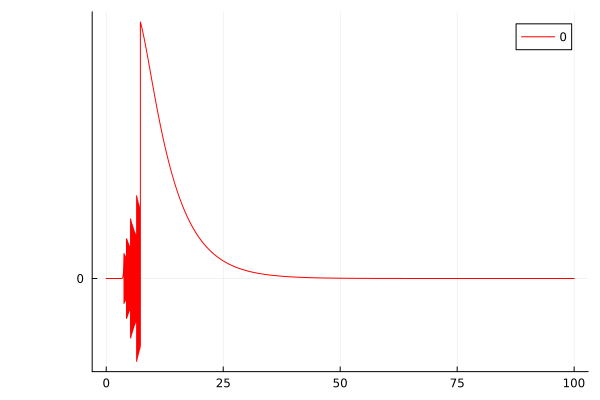

In [124]:
# histogram(data_1; normalize=:pdf, bins=1000)
plot(ddm_times, data_1_new, label="0", color=:red)

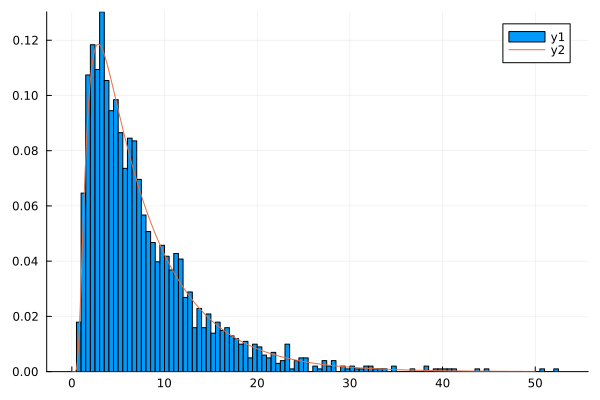

In [47]:
histogram(data_0; normalize=:pdf, bins=100)
plot!(ddm_times, ddm_probs_0 * 4.97)

In [3]:
# using the data from generated above, fit the DDM. Here we assume a single state model so no weights necessary.
naive_ddm = DriftDiffusionModel(9., 2., 2., 1.)
fit!(naive_ddm, data)

DriftDiffusionModel(9.980081613639204, 1.2572895346833004, 1.0869893928550627, 1.0)